# Visualizando conceptos

<img src='https://hdvirtual.us.es/discovirt/index.php/s/Za72Qpbr7GJ7T2k/preview' />


T1. Responde a las preguntas.
¿Que conceptos detectas que ha aprendido la VGG entrenada con ImageNet? Ten en cuenta las categorías del conjunto de datos ImageNet. Selecciona algunos y adjuntalos a la tarea.
Detectas conceptos diferentes aprendidos por la red para detectar expresiones faciales. ¿Que conceptos? Selecciona algunos y adjuntalos a la tarea.
¿Que cambios ves en la segunda red de detección de expresiones faciales?
T2
Hazte una foto y usala como semilla en el proceso de optimización. Establecer un número de pasos para que no desaparezcas por completo. Sube el resultado a la tarea.

In [1]:
import os
try:
    from google.colab import drive
    COLAB = True
    print("Estoy en Google CoLab")
except:
    os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
    os.environ["CUDA_VISIBLE_DEVICES"]="1"
    print("No estoy en Google CoLab")
    COLAB = False

No estoy en Google CoLab


In [2]:

import tensorflow as tf
import matplotlib
import urllib
import numpy as np
import random
import urllib
import os
%matplotlib inline
import matplotlib.pyplot as plt

In [3]:
def show_images(*args, tags=None):
    n = len(args[0])
    plt.figure(figsize=(20, 4*len(args)))
    for i in range(n):
        for j in range(len(args)):
            data = args[j][i]
            img = data['image']
            ax = plt.subplot(len(args), n, i + 1 + j*n)
            cmap = None if 'cmap' not in data else data['cmap']

            if len(img.shape) == 3 and img.shape[2] == 1:
                ax.imshow(img.reshape(img.shape[:2]), cmap=cmap)
            else:
                ax.imshow(img, cmap=cmap)

            ax.get_xaxis().set_visible(False)
            ax.get_yaxis().set_visible(False)

            if 'tag' in data:
                tags = data['tag']
                n_lines = len(tags.split('\n'))
                ax.text(0.0,-0.1 * n_lines, tags, size=12,
                        ha="left", transform=ax.transAxes)

    plt.show()

Visualizar patrones aprendidos consiste en mostrar **qué entrada produce un alto impacto** en una parte específica de la red. Ya hemos visto que las redes neuronales son **funciones diferenciables**, lo cual permite encontrar qué entrada provoca cierto comportamiento definiendo una función objetivo y usando los gradientes para actualizar los elementos que influyen en dicho objetivo.

En este caso, actualizaremos la **entrada a la red**, comenzando con una imagen aleatoria ruidosa, en lugar de actualizar los pesos como se hace al entrenar:

<img src='https://hdvirtual.us.es/discovirt/index.php/s/nPCfqaP9x9LxriB/preview' />

Este enfoque se conoce como **gradiente ascendente en el espacio de entrada**. Dependiendo del objetivo, podemos definir distintas funciones objetivo:

<img src='https://hdvirtual.us.es/discovirt/index.php/s/T8qTWj4e54ZxQTf/preview' width='75%' />

- Si queremos entender **patrones individuales**, buscamos imágenes que generen una **alta activación** en una neurona o canal determinado (cada canal extrae patrones independientes de los demás):

  ![deconvolution](https://hdvirtual.us.es/discovirt/index.php/s/mowctNfQYoB48iX/preview)

- Si queremos interpretar **una capa completa**, podemos usar el enfoque de **DeepDream**, buscando qué imágenes resultan interesantes para toda la capa.

- Si queremos generar imágenes que activen **una clase concreta**, tenemos dos opciones:
  1. Optimizar las **entradas a la softmax** (logits).
  2. Optimizar la **salida de la softmax** (probabilidades).

  Optimizar la salida de la softmax puede ser contraproducente, ya que se puede aumentar la probabilidad de una clase simplemente reduciendo la evidencia de las otras. Por eso, **optimizar los logits** suele producir imágenes de mayor calidad.

Estos son solo algunos ejemplos. Por ejemplo, en **transferencia de estilo**, se diseñan objetivos para capturar el estilo y contenido de imágenes específicas.

---

## Gradiente Ascendente en el Espacio de Entrada

El proceso es sencillo si usamos las herramientas adecuadas. Construimos una función de pérdida que maximice:

- La salida de un filtro específico,
- La activación completa de una capa,
- O la entrada a la softmax para una clase determinada.

Empezamos con una imagen aleatoria (como los pesos al iniciar una red), y usamos SGD o Adam para ajustar dicha imagen con el objetivo de maximizar los valores de los mapas de características.


In [4]:
base_model = tf.keras.applications.VGG16(weights='imagenet', include_top=False)

layer_name = 'block3_conv1'
filter_index = 0

layer_output = base_model.get_layer(layer_name).output

class MeanFilter(tf.keras.layers.Layer):
    def __init__(self, filter_index) -> None:
        super().__init__()

        self.filter_index = filter_index

    def call(self, x):
        return tf.reduce_mean(x[:, :, :, self.filter_index])

#loss = tf.reduce_mean(layer_output[:, :, :, filter_index])
loss = MeanFilter(filter_index)(layer_output)

loss_model = tf.keras.models.Model(base_model.inputs, loss)

In [5]:
loss_model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, None, None, 3)  │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, None, None, 64) │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, None, None, 64) │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, None, None, 64) │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, None, None,     │        73,856 │
│                                 │ 128)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, None, None,     │       147,584 │
│                                 │ 128)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, None, None,     │             0 │
│                                 │ 128)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, None, None,     │       295,168 │
│                                 │ 256)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mean_filter (MeanFilter)        │ ()                     │             0 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 555,328 (2.12 MB)

 Trainable params: 555,328 (2.12 MB)

 Non-trainable params: 0 (0.00 B)

Para implementar el descenso del gradiente necesitamos calcular el **gradiente de la función de pérdida respecto a las entradas del modelo**, para lo cual usaremos `tf.GradientTape`.

In [6]:
# Empezamos con una imagen gris ruidosa.
input_img_data = tf.constant(np.random.random((1, 96, 96, 3)) * 20 + 128.)

print(loss_model(input_img_data))

# `gradients` devuelve una lista de tensores (de tamaño 1 en este caso)
with tf.GradientTape() as tape:
    tape.watch(input_img_data)
    loss = loss_model(input_img_data)

tf.Tensor(59.682102, shape=(), dtype=float32)


/Users/sergiosantiago/developments/master/AP/S8/venv/lib/python3.11/site-packages/keras/src/models/functional.py:238: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['keras_tensor']
Received: inputs=Tensor(shape=(1, 96, 96, 3))
  warnings.warn(msg)


Con el fin de asegurar que la magnitud de las actualizaciones se mantengan en un rango adecuado, normalizaremos el gradiente (dividiéndolo por la norma L2 y sumando una pequeña cantidad fija para que no haya problemas de división por 0).


In [7]:
grads = tape.gradient(loss, input_img_data)

grads /= (tf.sqrt(tf.reduce_mean(tf.pow(grads, 2))) + 1e-5)

input_img_data += grads

input_img_data

<tf.Tensor: shape=(1, 96, 96, 3), dtype=float64, numpy=
array([[[[131.20366229, 142.89384904, 135.00873953],
         [133.36218506, 127.95832055, 139.41997051],
         [133.93030096, 144.07534486, 128.30371349],
         ...,
         [147.89488963, 141.79787037, 141.62247239],
         [139.23164106, 143.94116984, 147.48147124],
         [147.14573486, 139.16648126, 145.23611614]],

        [[129.62605631, 146.76335673, 142.25911704],
         [130.85458975, 144.61201316, 131.42091645],
         [147.27769901, 133.15397055, 145.50306253],
         ...,
         [134.39927177, 128.85065229, 130.79736872],
         [133.67065697, 135.0583062 , 134.58538083],
         [139.01150548, 128.05947056, 133.29224774]],

        [[145.9407164 , 135.04032578, 130.49240432],
         [134.01107584, 143.82642112, 145.8318051 ],
         [130.72796783, 129.40196235, 133.60689661],
         ...,
         [131.72158367, 132.41377378, 130.33544929],
         [138.19466711, 135.32700039, 142.49347262

Lo anterior sería un paso en el proceso de optimización. La siguiente función implementa el bucle de optimización completo:

In [8]:
def generate_pattern(loss_model, size=96, steps=40, return_steps=False, lr=1., verbose=False, im=None):


    # Creamos una imagen aleatoria
    if im is None:
        im = tf.random.normal((1, size, size, 3), mean=128., stddev=20.)
    else:
        im = tf.convert_to_tensor(im)
    im = tf.keras.applications.vgg16.preprocess_input(im) 

    # Ejecutamos el gradiente ascendente
    lr = 1.

    ax = None
    images = []
    loss = tf.constant(0.0)
    for i in range(steps):

        with tf.GradientTape() as tape:
            tape.watch(im)
            loss = loss_model(im)
            
            if verbose:
                print(loss)

        # calculamos los gradientes y actualizamos
        grads = tape.gradient(loss, im)

        grads /= (tf.sqrt(tf.reduce_mean(tf.pow(grads, 2))) + 1e-5)

        im = im + grads * lr

        if return_steps:
            #arr = np.copy(im)
            images.append(im)


    if return_steps:
        images.append(im)
        return images
    else:
        return im

Además, vamos a necesitar una función para invertir el preprocesado de la VGG16:

In [9]:
def deprocess_image(x):
    # normalizamos el tensor: centrado en 0. y con std 0.1
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1

    # desplazamos 0.5 para hacerlos positivos y eliminamos lo que este fuera del rango [0, 1]
    x += 0.5
    x = np.clip(x, 0, 1)

    # convertimos a BGR
    x *= 255
    x = np.clip(x, 0, 255).astype('uint8')
    return x



En el siguiente ejemplo vamos a visualizar qué tipo de patrón activa fuertemente el **filtro 1** de la capa `'block5_conv2'` en el modelo VGG16 preentrenado.

Primero, seleccionamos la capa deseada (`block5_conv2`) y el filtro a maximizar (filtro `1`). Luego, definimos una función de pérdida que representa la activación media de ese filtro. Para ello, usamos una clase `MeanFilter` que calcula la activación promedio del filtro especificado dentro de la salida de la capa.

Construimos un nuevo modelo (`loss_model`) que toma como entrada una imagen y devuelve esta función de pérdida. A partir de ahí, usamos la función `generate_pattern` para realizar **gradiente ascendente en el espacio de entrada**, optimizando una imagen inicial aleatoria para maximizar dicha activación. Finalmente, visualizamos el resultado con `matplotlib`.

Este proceso nos permite ver qué tipo de patrones visuales "prefiere" ese filtro en particular, es decir, a qué tipo de estímulos es más sensible.



/Users/sergiosantiago/developments/master/AP/S8/venv/lib/python3.11/site-packages/keras/src/models/functional.py:238: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['keras_tensor_20']
Received: inputs=Tensor(shape=(1, 96, 96, 3))
  warnings.warn(msg)


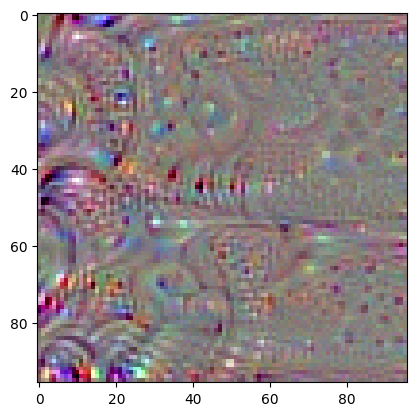

In [10]:
layer_name = 'block5_conv2'
filter_index = 1

# Creamos la función a maximizar.
# En este caso vamos a usar maximizar una capa refiriendonos al filtro
# que la genera:
base_model = tf.keras.applications.VGG16(weights='imagenet', include_top=False)

layer_output = base_model.get_layer(layer_name).output

loss = MeanFilter(filter_index)(layer_output)

loss_model = tf.keras.models.Model(inputs=base_model.inputs, outputs=loss)

image = generate_pattern(loss_model, 96, steps=100, return_steps=False, lr=0.001, verbose=False)

plt.imshow(deprocess_image(image[0].numpy()))

Una forma intuitiva y didáctica de entender el proceso de **gradiente ascendente** es visualizar cómo evoluciona la imagen optimizada a lo largo de las iteraciones. En lugar de mostrar solo el resultado final, aquí generamos una **animación** que muestra cómo una imagen aleatoria se transforma progresivamente hasta convertirse en un patrón que maximiza la activación de un filtro concreto.

Usamos la opción `return_steps=True` en la función `generate_pattern` para guardar cada paso intermedio del proceso de optimización. Luego, las imágenes se transforman (con `deprocess_image`) para poder visualizarse correctamente.

Con la ayuda de `matplotlib.animation` y `FuncAnimation`, creamos una animación que muestra esta evolución iterativa. Finalmente, la animación se incrusta en la notebook como un video HTML. Esta técnica es muy útil para comprender de manera visual e intuitiva cómo la red "construye" patrones que activan ciertos filtros específicos.


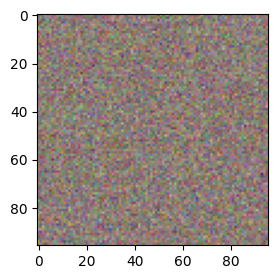

In [11]:
from matplotlib import animation, rc
from IPython.display import HTML

images = generate_pattern(loss_model, 96, steps=100, return_steps=True, lr=1)
images = [deprocess_image(im.numpy()[0, :, :, :]) for im in images]

fig, ax = plt.subplots(figsize=(3, 3))
im = ax.imshow(images[0])

def _init():
    im.set_data(images[0])
    return (im, )


def _animate(i):
    im.set_data(images[(i+1)%len(images)])
    return (im, )

anim = animation.FuncAnimation(fig, _animate, init_func=_init,
                               frames=len(images), interval=100, blit=True)
HTML(anim.to_html5_video())


Lo interesante es que podemos visualizar todos los fitros de cada capa. En el ejemplo siguiente se muestra cómo obtener una visualización de los 64 primeros filtros de cada capa convolucional de los primeros 4 bloques, y los mostramos como una malla de 8x8 patrones:


/Users/sergiosantiago/developments/master/AP/S8/venv/lib/python3.11/site-packages/keras/src/models/functional.py:238: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['keras_tensor_20']
Received: inputs=Tensor(shape=(1, 96, 96, 3))
  warnings.warn(msg)


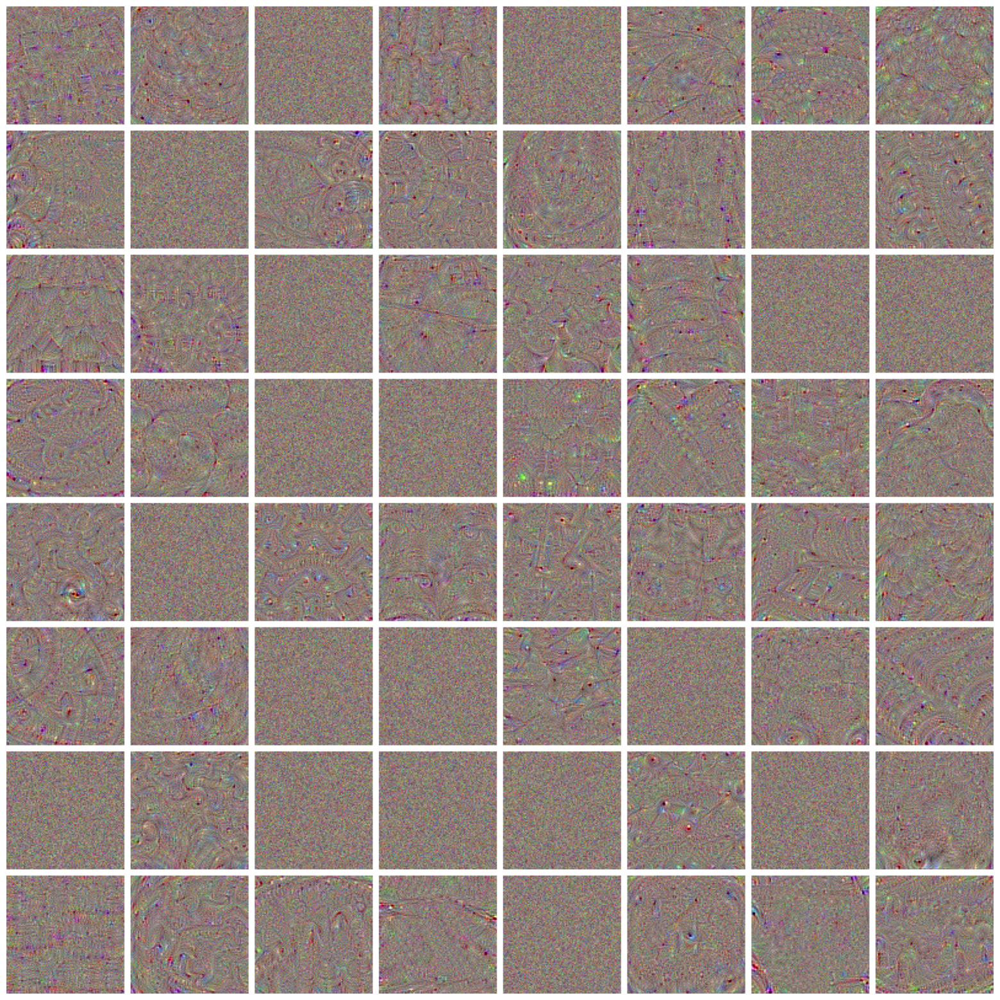

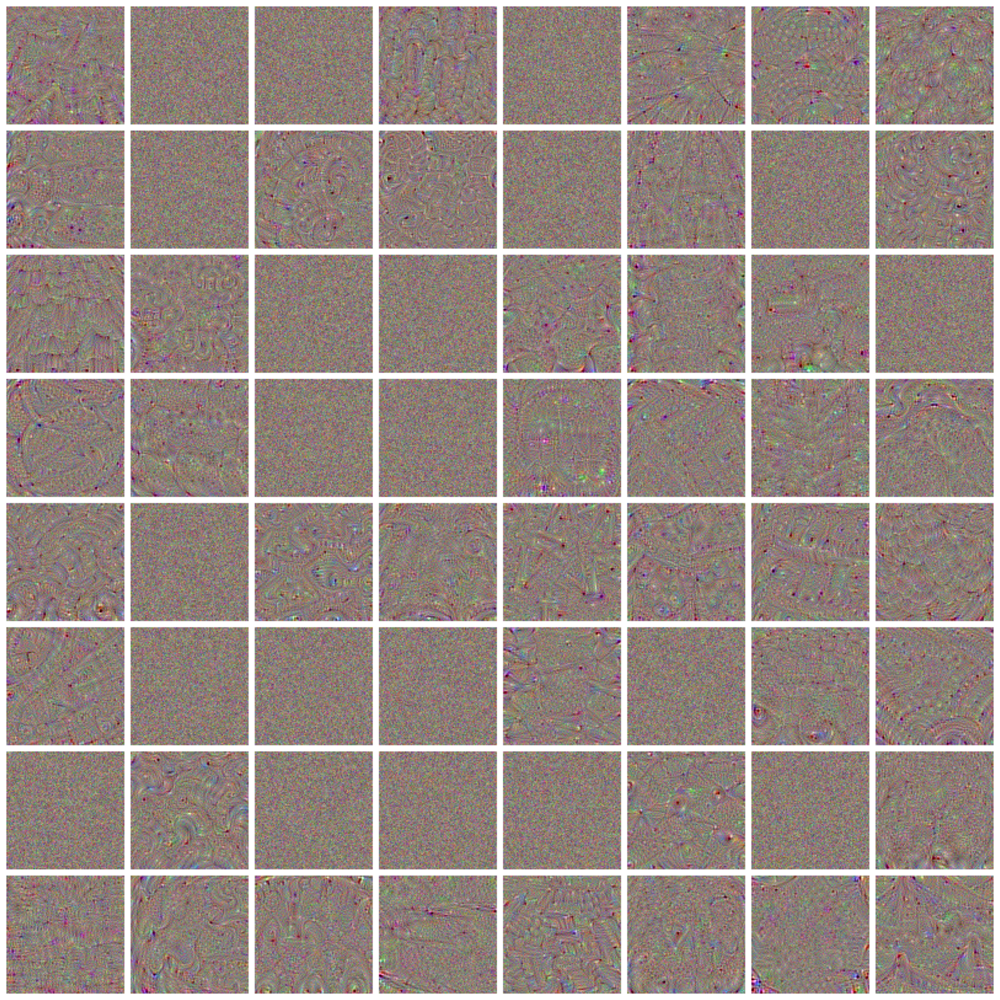

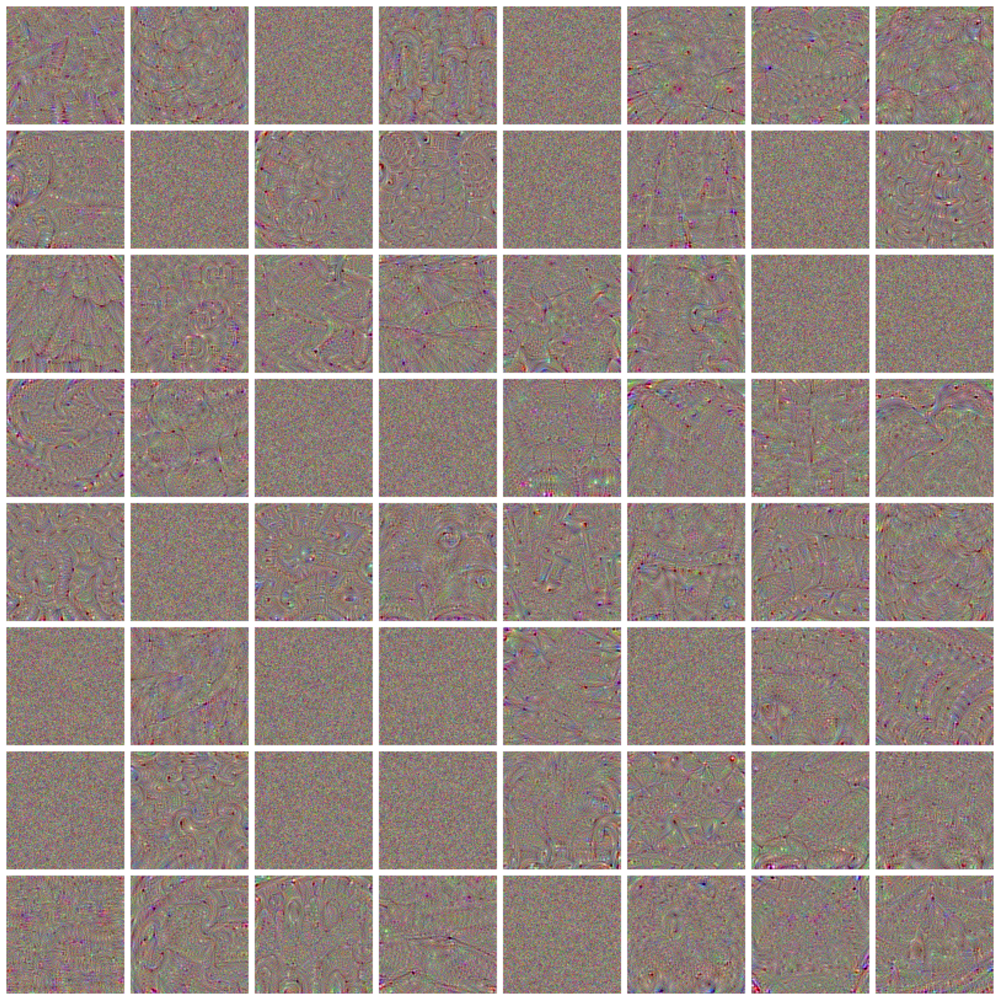

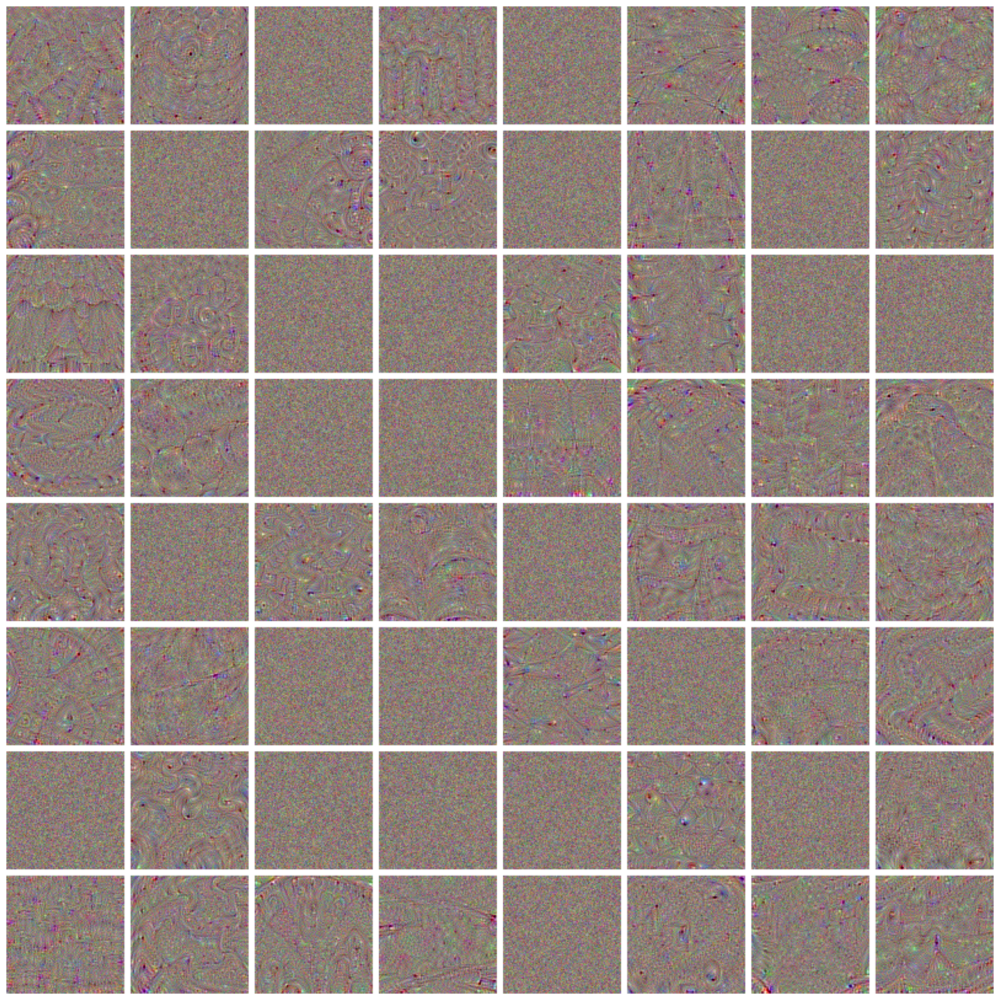

KeyboardInterrupt: 

In [14]:
tf.get_logger().setLevel('INFO')
tf.autograph.set_verbosity(0)

LAYERS =  ['block1_conv1', 
           'block2_conv2', 
           'block3_conv3', 
           'block4_conv3', 
           'block5_conv3'
          ]

def get_kernel_concept(base_model, filter_index, size, steps, lr):
    layer_output = base_model.get_layer(layer_name).output

    loss = MeanFilter(filter_index)(layer_output)

    loss_model = tf.keras.models.Model(inputs=base_model.inputs, outputs=loss)


    # Generate the pattern for filter `i + (j * 8)` in `layer_name`
    filter_img = generate_pattern(loss_model, size=size, steps=steps, lr=lr)
    filter_img = deprocess_image(filter_img[0].numpy())

    return filter_img

def show_kernel_concepts(base_model, layers, steps=10, lr=1.0):
    
    for layer_name in layers:
        size = 96
        margin = 5

        # This a empty (black) image where we will store our results.
        results = np.zeros((8 * size + 7 * margin, 8 * size + 7 * margin, 3))
        results += 255

        for i in range(8):  # iterate over the rows of our results grid
            for j in range(8):  # iterate over the columns of our results grid

                filter_index = i + (j * 8)
                
                filter_img = get_kernel_concept(base_model, filter_index, size, steps, lr)

                # Put the result in the square `(i, j)` of the results grid
                horizontal_start = i * size + i * margin
                horizontal_end = horizontal_start + size
                vertical_start = j * size + j * margin
                vertical_end = vertical_start + size
                results[horizontal_start: horizontal_end, vertical_start: vertical_end, :] = filter_img

        # Display the results grid
        plt.figure(figsize=(20, 20))
        plt.imshow(results/255)
        plt.axis('off')
        plt.show()

show_kernel_concepts(base_model, LAYERS, steps=20, lr=1.0)

Estas visualizaciones dan mucha información acerca de cómo las capas convolucionales ven el mundo, de forma similar a cómo la transformada de Fourier descompone las señales como una colección de funciones coseno. Observa cómo el patrón de los filtros se vuelve más complejo a medida que se profundiza en la red.

¿Que conceptos detectas que ha aprendido la VGG entrenada con ImageNet? Ten en cuenta las categorías del conjunto de datos ImageNet. Selecciona algunos y adjuntalos a la tarea.

Conforme aumentamos el número de iteraciones podemos observar con mayor nitidez los conceptos aprendidos por la red. En el caso de imagenet con las iteraciones establecidas, puede intuirse que la red aprende a identificar superficies de animales, por ejemplo, plumas o escamas.

### T1

Visualiza ahora los conceptos aprendidos por el modelo para reconocer las expresiones faciales para responder a las preguntas de la actividad:

In [12]:
model_url = 'https://hdvirtual.us.es/discovirt/index.php/s/56Go2HStYwmrLmZ/download'
urllib.request.urlretrieve(model_url, 'face_expressions.keras')

face_model = tf.keras.models.load_model('./face_expressions.keras')

In [15]:
LAYERS =  ['block4_conv3', 'block5_conv3']

show_kernel_concepts(face_model, LAYERS, steps=20, lr=0.1)

/Users/sergiosantiago/developments/master/AP/S8/venv/lib/python3.11/site-packages/keras/src/models/functional.py:238: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['input_layer']
Received: inputs=Tensor(shape=(1, 96, 96, 3))
  warnings.warn(msg)


KeyboardInterrupt: 

In [16]:
class MeanLayer(tf.keras.layers.Layer):
    def __init__(self) -> None:
        super().__init__()

    def call(self, x):
        return tf.reduce_mean(x)
    
def show_layer_concepts(base_model, layers, steps=10, lr=1.0):
    
    size = 96
    margin = 5

    rows = int(np.ceil(len(layers) / 8))
    # This a empty (black) image where we will store our results.
    results = np.zeros((rows * size + 7 * margin,8 * size + 7 * margin, 3))
    results += 255
   
    for k, layer_name in enumerate(layers):

        layer_output = base_model.get_layer(layer_name).output
        loss = MeanLayer()(layer_output)

        loss_model = tf.keras.models.Model(inputs=base_model.inputs, outputs=loss)


        # Generamos el patrón para la capa
        filter_img = generate_pattern(loss_model, size=size, steps=steps, lr=lr)
        filter_img = deprocess_image(filter_img[0].numpy())

        # 
        j = k // 8
        i = k - (j * 8)
        
        
        horizontal_start = i * size + i * margin
        horizontal_end = horizontal_start + size
        vertical_start = j * size + j * margin
        vertical_end = vertical_start + size
        results[vertical_start: vertical_end,horizontal_start: horizontal_end, :] = filter_img
        

    # Display the results grid
    plt.figure(figsize=(20, 20))
    plt.imshow(results/255)
    plt.axis('off')
    plt.show()


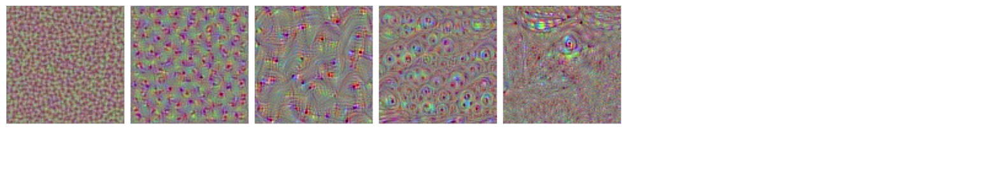

In [39]:
LAYERS =  ['block1_conv2', 'block2_conv2','block3_conv3', 'block4_conv3', 'block5_conv3']
show_layer_concepts(face_model, LAYERS, steps=30, lr=0.001)

Detectas conceptos diferentes aprendidos por la red para detectar expresiones faciales. ¿Que conceptos? Selecciona algunos y adjuntalos a la tarea.

En el modelo de las expresiones faciles podemos intuir que ha aprendido conceptos como la sonrisa, probablemente cuando la persona de la fotografía muestra los dientes sobretodo, y los ojos.

Segundo modelo

In [19]:
model_url = 'https://hdvirtual.us.es/discovirt/index.php/s/dXt7niSkSXanPDS/download'
urllib.request.urlretrieve(model_url, 'face_expressions2.keras')

face_model2 = tf.keras.models.load_model('./face_expressions2.keras')

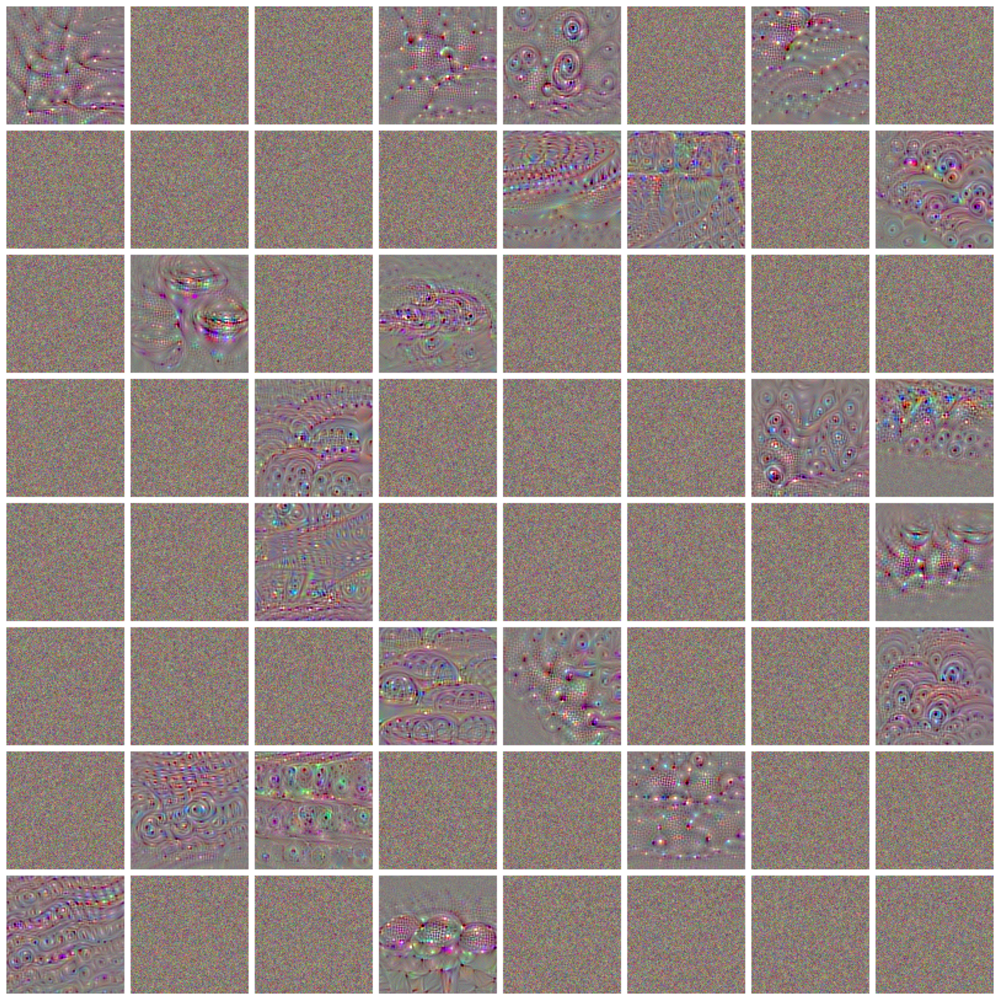

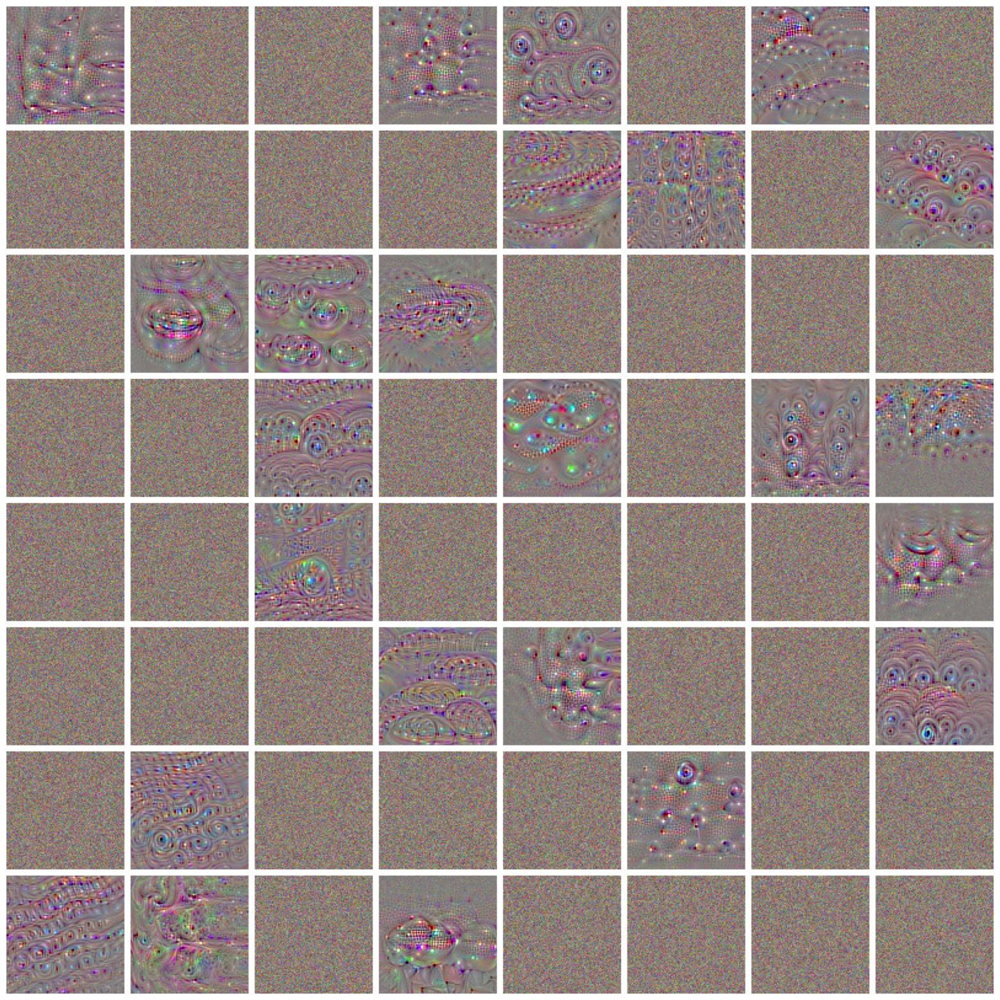

In [34]:
LAYERS =  ['block4_conv3', 'block5_conv3']

show_kernel_concepts(face_model2, LAYERS, steps=100, lr=0.1)

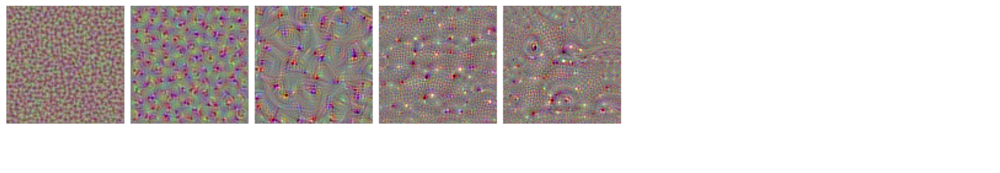

In [37]:
LAYERS =  ['block1_conv2', 'block2_conv2','block3_conv3', 'block4_conv3', 'block5_conv3']
show_layer_concepts(face_model2, LAYERS, steps=30, lr=0.001)

¿Que cambios ves en la segunda red de detección de expresiones faciales?

En el segundo modelo, aunque parece algo más abstracto, diría que al igual que el anterior, este también se ha fijado en elementos como los ojos y la boca, pero en este caso también puedo apreciar algunos casos en los que podemos apreciar una nariz y en definitiva la sección de entre los ojos y la boca.

#### T2. 

Hazte una foto y usala como semilla en el proceso de optimización. Establecer un número de pasos para que no desaparezcas por completo. Sube el resultado a la tarea.

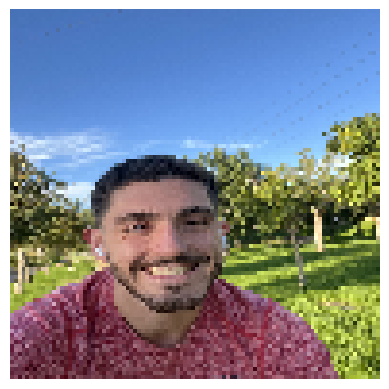

Expanded tensor shape: (1, 96, 96, 3)


In [23]:
import cv2
img_path = "sss.jpeg"
img_tensor_face = cv2.imread(img_path)
img_tensor_face = cv2.cvtColor(img_tensor_face, cv2.COLOR_BGR2RGB)
img_tensor_face = cv2.resize(img_tensor_face, (96, 96))

plt.imshow(img_tensor_face)
plt.axis('off')
plt.show()

img_tensor_face = np.expand_dims(img_tensor_face, axis=0)
img_tensor_face = tf.keras.applications.vgg16.preprocess_input(img_tensor_face)

print('Expanded tensor shape:', img_tensor_face.shape)

In [24]:
face_model2.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 96, 96, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 96, 96, 64)     │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 96, 96, 64)     │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 48, 48, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 48, 48, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 48, 48, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 24, 24, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 24, 24, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 24, 24, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 24, 24, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 12, 12, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 12, 12, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 12, 12, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 12, 12, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 6, 6, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 6, 6, 512)      │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 6, 6, 512)      │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 6, 6, 512)      │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 3, 3, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 4608)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 256)            │     1,179,904 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 4)              │           516 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 44,313,038 (169.04 MB)

 Trainable params: 14,192,516 (54.14 MB)

 Non-trainable params: 1,735,488 (6.62 MB)

 Optimizer params: 28,385,034 (108.28 MB)

/Users/sergiosantiago/developments/master/AP/S8/venv/lib/python3.11/site-packages/keras/src/models/functional.py:238: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['input_layer']
Received: inputs=Tensor(shape=(1, 96, 96, 3))
  warnings.warn(msg)


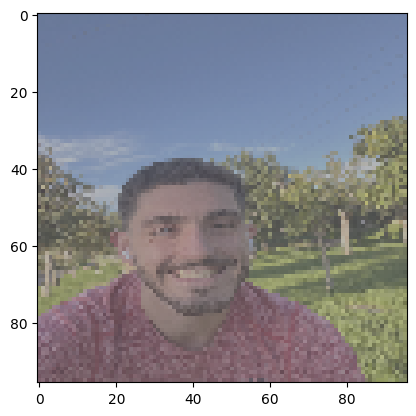

In [26]:
layer_name = 'block5_conv2'
filter_index = 1

layer_output = face_model.get_layer(layer_name).output

loss = MeanFilter(filter_index)(layer_output)

loss_model = tf.keras.models.Model(inputs=face_model.inputs, outputs=loss)

image = generate_pattern(loss_model, 96, steps=100, return_steps=False, lr=0.001, verbose=False, im=img_tensor_face)
plt.imshow(deprocess_image(image[0].numpy()))